In [1]:
import pylab as pl
import numpy as np
from astropy.visualization import quantity_support
from astropy import units as u
from astropy import wcs

pl.rcParams['figure.facecolor']='w'

from spectral_cube import SpectralCube
from pvextractor import extract_pv_slice, Path
import matplotlib.pyplot as plt
from astropy.wcs import WCS

import pyspeckit
import astropy.units as u
import astropy.wcs as wcs
import aplpy as aplpy
from astropy.io import fits
from astropy.wcs.utils import skycoord_to_pixel
from astropy.coordinates import SkyCoord

In [2]:
cube=SpectralCube.read('/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/N2Dp/HOPS164_N2Dp_Tp12m7m_large_Combine_pbcor.fits')

In [3]:
def plot_contours(fits_file, color, min_level, max_level, number_of_levels):

    gamma = 2.0
    scaled_levels = np.linspace(0, 1, number_of_levels) ** gamma
    levels_continuum = min_level + (max_level - min_level) * scaled_levels
    
    return ax.contour(fits_file, colors=color, levels=levels_continuum, linewidths=1.5)

# Define the center and size of the region in world coordinates
ra_center = 84.2518  # RA center in degrees
dec_center = -6.6196  # DEC center in degrees
width_N2Dp = 0.0172  # RA width in degrees
height_N2Dp = 0.0172  # DEC height in degrees

width = 0.0145  # RA width in degrees
height = 0.0145  # DEC height in degrees

# Convert world coordinates to pixel coordinates
center = SkyCoord(ra_center, dec_center, unit='deg', frame='icrs')
x_center, y_center = skycoord_to_pixel(center, cube.wcs.celestial)

# Calculate pixel limits based on the desired width and height
x_width = width / abs(cube.wcs.celestial.wcs.cdelt[0])  # RA pixel scale
y_height = height / abs(cube.wcs.celestial.wcs.cdelt[1])  # DEC pixel scale

blue = '#1E88E5'
orange = '#FF6F61'
yellow = '#FDD835'

In [4]:
cube_name = '/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/CO/HOPS164_CO_Tp12m7m_Combine_pbcor_masked.fits'

cube_sc = SpectralCube.read(cube_name)
cube_sc.allow_huge_operations = True 
cube_sc = cube_sc.to(u.K).with_spectral_unit(u.km/u.s)

cube = pyspeckit.Cube(cube=cube_sc)
cube.xarr.velocity_convention ='radio'
spectral_axis = cube_sc.spectral_axis

slab1 = cube_sc.spectral_slab(0*u.km/u.s, 4.2*u.km/u.s)
Mom0_blue = slab1.moment0()

slab_red = cube_sc.spectral_slab(7.2*u.km/u.s, 11.6*u.km/u.s)
Mom0_red = slab_red.moment0()

# N2D+

In [5]:
cube=SpectralCube.read('/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/N2Dp/HOPS164_N2Dp_Tp12m7m_large_Combine_pbcor.fits')

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

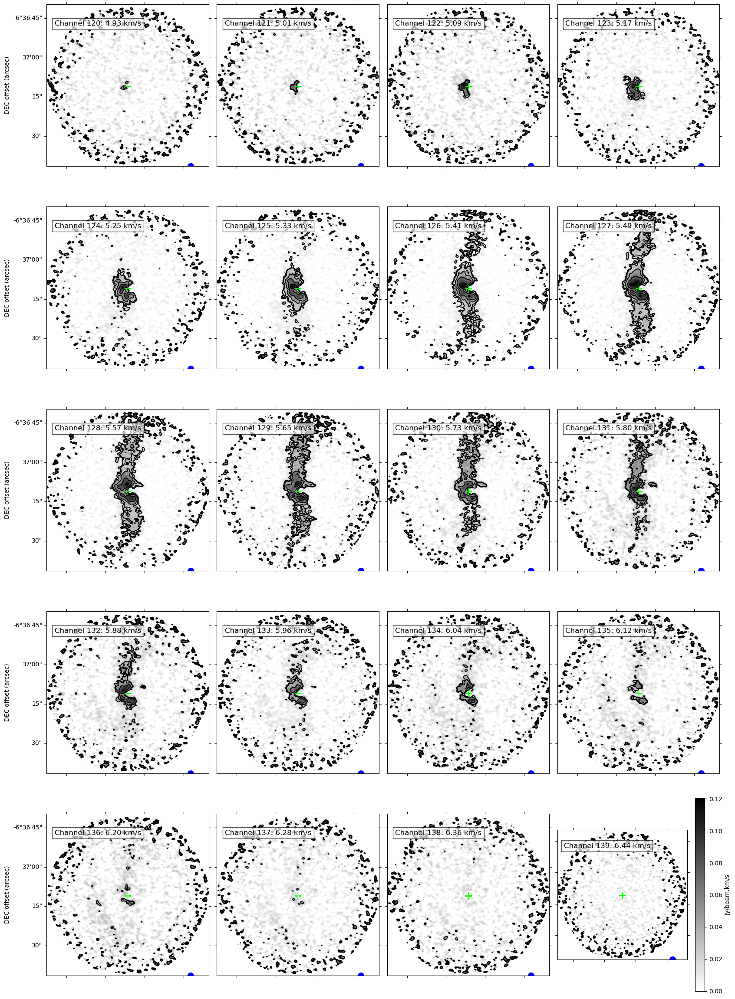

In [13]:
# Calculate pixel limits based on the desired width and height
x_width_N2Dp = width_N2Dp / abs(cube.wcs.celestial.wcs.cdelt[0])  # RA pixel scale
y_height_N2Dp = height_N2Dp / abs(cube.wcs.celestial.wcs.cdelt[1])  # DEC pixel scale

fig, axes = plt.subplots(5, 4, figsize=(20, 30), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(120, 140)):  
    row = idx // 4  # Calculate the row index (0 to 4)
    col = idx % 4   # Calculate the column index (0 to 4)
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.20, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width_N2Dp / 2, x_center + x_width_N2Dp / 2)
    ax.set_ylim(y_center - y_height_N2Dp / 2, y_center + y_height_N2Dp / 2)

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

     # Add a beam size marker in the bottom right corner
    ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 20:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('RA offset (arcsec)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('DEC offset (arcsec)')

    # Hide tick labels for non-edge plots
    if row < 20:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

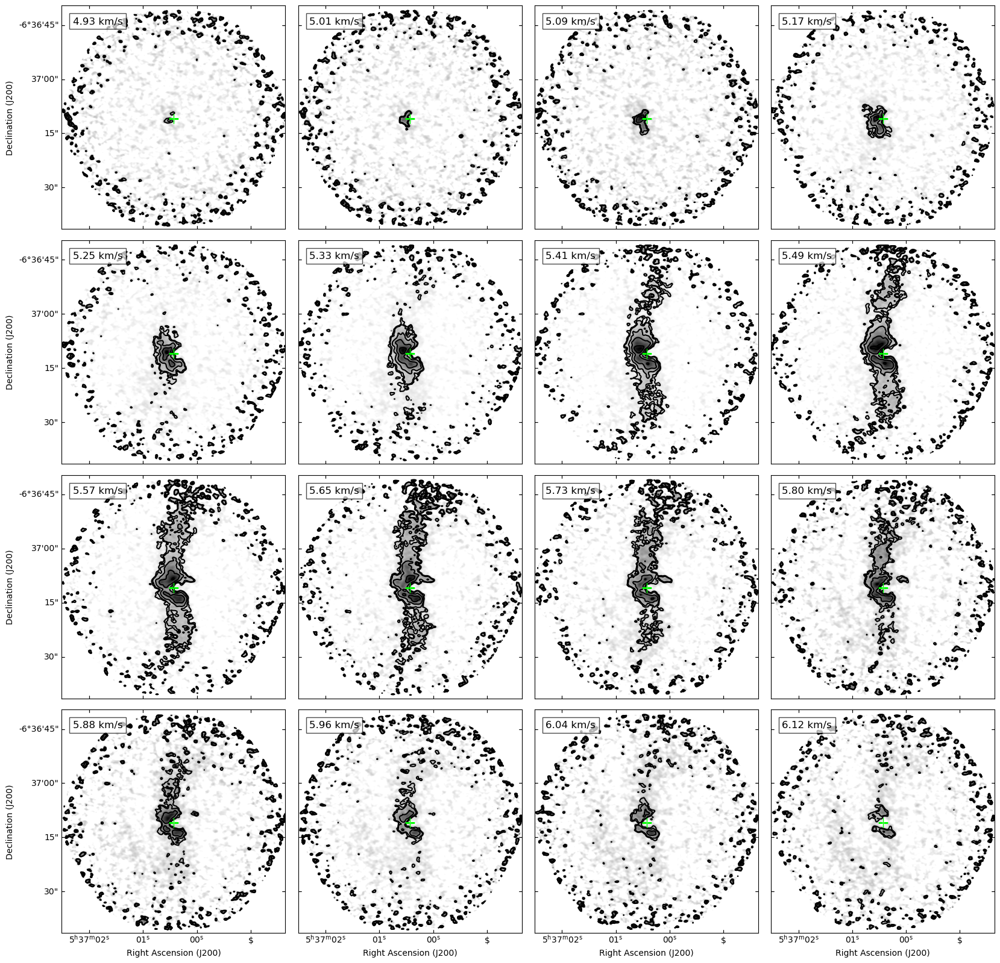

In [22]:
# Calculate pixel limits based on the desired width and height
x_width_N2Dp = width_N2Dp / abs(cube.wcs.celestial.wcs.cdelt[0])  # RA pixel scale
y_height_N2Dp = height_N2Dp / abs(cube.wcs.celestial.wcs.cdelt[1])  # DEC pixel scale

fig, axes = plt.subplots(4, 4, figsize=(20, 20), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(120, 136)):  # Adjust this.
    row = idx // 4  # Calculate the row index (0 to 4)
    col = idx % 4   # Calculate the column index (0 to 4)
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.20, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    # ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
    #     verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))
    
    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.95, f"{velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width_N2Dp / 2, x_center + x_width_N2Dp / 2)
    ax.set_ylim(y_center - y_height_N2Dp / 2, y_center + y_height_N2Dp / 2)
    
    # Move ticks inside
    ax.tick_params(axis='both', direction='in', which='both')

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

     # Add a beam size marker in the bottom right corner
    # ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 3:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('Right Ascension (J200)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('Declination (J200)')

    # Hide tick labels for non-edge plots
    if row < 3:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
# plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.savefig("HOPS164_N2Dp_channels.png", format="png", dpi=300, bbox_inches="tight")
plt.show()

# With outflows

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

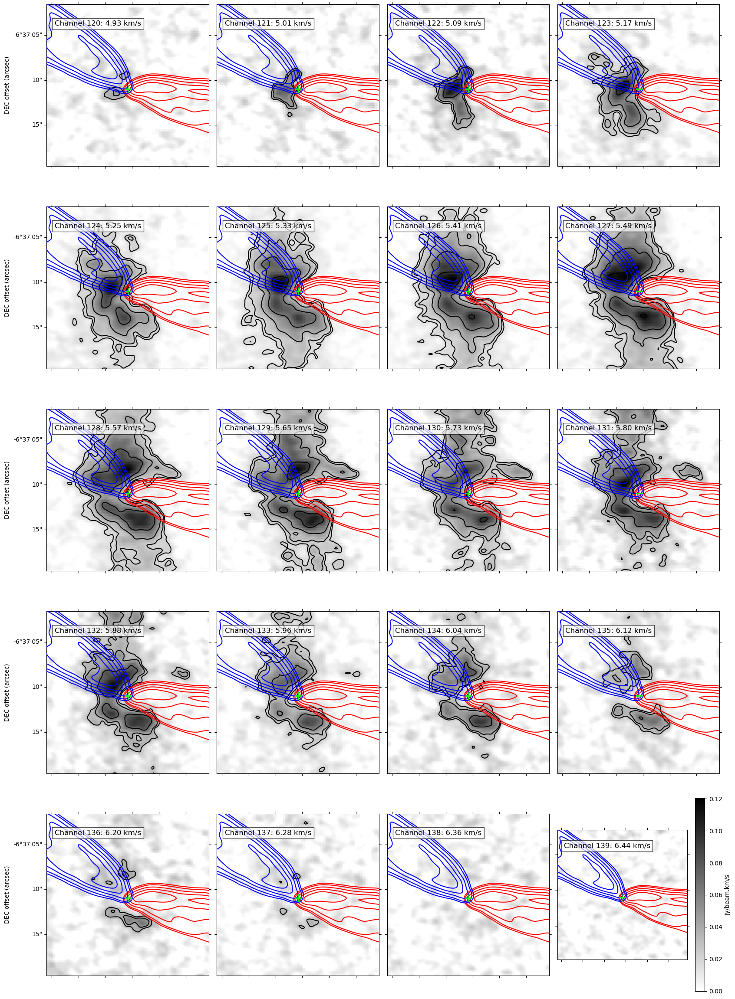

In [18]:
width_N2Dp = 0.005  # RA width in degrees
height_N2Dp = 0.0050  # DEC height in degrees

# Calculate pixel limits based on the desired width and height
x_width_N2Dp = width_N2Dp / abs(cube.wcs.celestial.wcs.cdelt[0])  # RA pixel scale
y_height_N2Dp = height_N2Dp / abs(cube.wcs.celestial.wcs.cdelt[1])  # DEC pixel scale

fig, axes = plt.subplots(5, 4, figsize=(20, 30), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(120, 140)):  # Adjust this.
    row = idx // 4  # Calculate the row index (0 to 4)
    col = idx % 4   # Calculate the column index (0 to 4)
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.20, 5)

    plot_contours(Mom0_red.value, 'red', 15, 50, 5)
    plot_contours(Mom0_blue.value, 'blue', 4, 40, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width_N2Dp / 2, x_center + x_width_N2Dp / 2)
    ax.set_ylim(y_center - y_height_N2Dp / 2, y_center + y_height_N2Dp / 2)

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

     # Add a beam size marker in the bottom right corner
    ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 5:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('RA offset (arcsec)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('DEC offset (arcsec)')

    # Hide tick labels for non-edge plots
    if row < 5:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()

# H2CO

In [19]:
cube=SpectralCube.read('/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/H2CO/HOPS164_H2CO_Tp12m7m_Combine_pbcor_masked.fits')

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

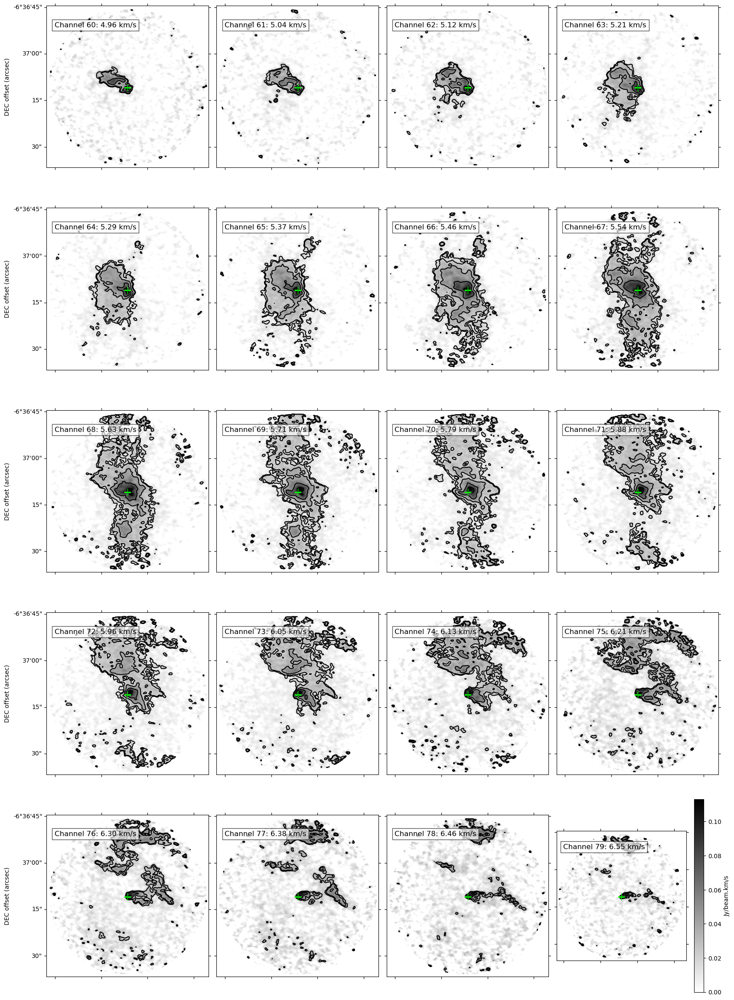

In [25]:
fig, axes = plt.subplots(5, 4, figsize=(20, 30), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(60, 80)): 
    row = idx // 4  
    col = idx % 4  
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.20, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width / 2, x_center + x_width / 2)
    ax.set_ylim(y_center - y_height / 2, y_center + y_height / 2)

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

    # Add a beam size marker in the bottom right corner
    ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 5:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('RA offset (arcsec)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('DEC offset (arcsec)')

    # Hide tick labels for non-edge plots
    if row < 5:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.show()

# C18O

In [26]:
cube=SpectralCube.read('/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/C18O/HOPS164_C18O_Tp12m7m_Combine_pbcor_masked.fits')

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

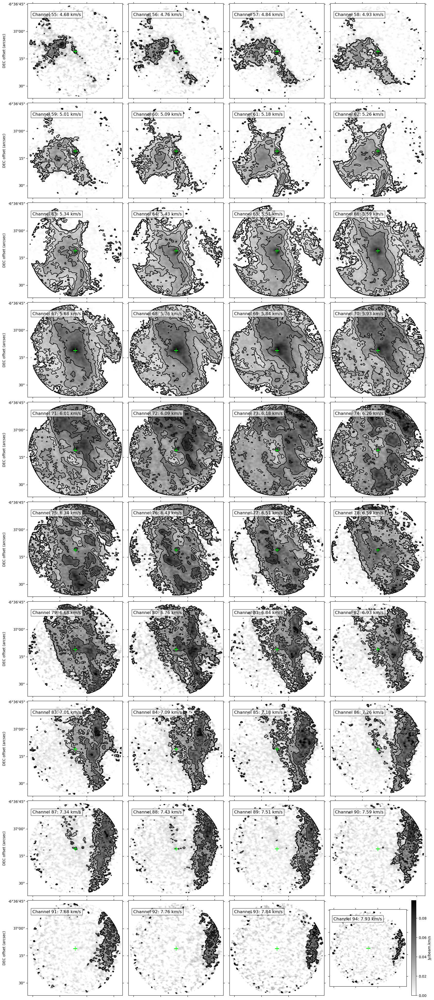

In [30]:
fig, axes = plt.subplots(10, 4, figsize=(20, 50), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(55, 95)):  
    row = idx // 4  
    col = idx % 4  
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.20, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width / 2, x_center + x_width / 2)
    ax.set_ylim(y_center - y_height / 2, y_center + y_height / 2)

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

    # Add a beam size marker in the bottom right corner
    ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 10:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('RA offset (arcsec)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('DEC offset (arcsec)')

    # Hide tick labels for non-edge plots
    if row < 10:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.show()

# 13CO

In [31]:
cube=SpectralCube.read('/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/13CO/HOPS164_13CO_Tp12m7m_Combine_pbcor_masked.fits')

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

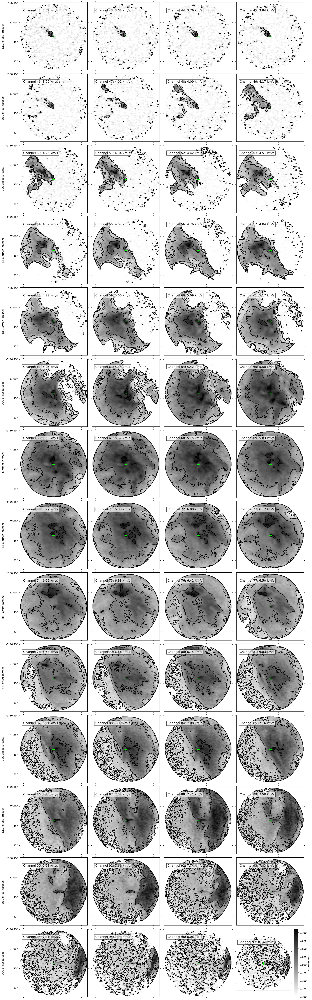

In [34]:
fig, axes = plt.subplots(14, 4, figsize=(20, 70), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(42, 98)):  
    row = idx // 4  
    col = idx % 4   
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.50, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width / 2, x_center + x_width / 2)
    ax.set_ylim(y_center - y_height / 2, y_center + y_height / 2)

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

    # Add a beam size marker in the bottom right corner
    ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 14:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('RA offset (arcsec)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('DEC offset (arcsec)')

    # Hide tick labels for non-edge plots
    if row < 14:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.show()

# 12CO

In [35]:
cube=SpectralCube.read('/Users/ivarismartinez/Desktop/Research/REU23/ALMA/HOPS164/CO/HOPS164_CO_Tp12m7m_Combine_pbcor_masked.fits')

WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1 is missing card PV2_1
WCS1 is missing card PV2_2
WCS1 is missing card TIMESYS
WCS1

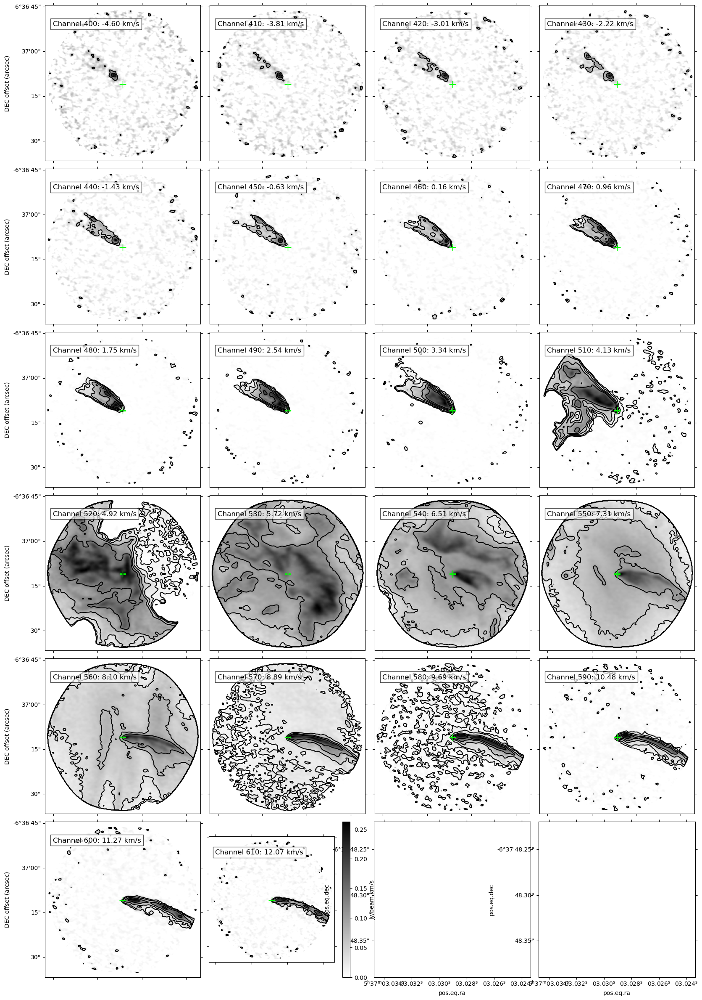

In [39]:
fig, axes = plt.subplots(6, 4, figsize=(20, 30), subplot_kw={'projection': cube.wcs.celestial})

for idx, i in enumerate(range(400, 620, 10)): 
    row = idx // 4  
    col = idx % 4   
    ax = axes[row, col]

    # Plot the data slice
    im = ax.imshow(cube[i].value, cmap='binary', origin='lower', vmin=0)

    # Plot contours with proper data handling
    contour_data = np.nan_to_num(cube[i].value)  # Replace NaNs with zeros
    plot_contours(contour_data, 'black', 0.03, 0.50, 5)

    # Get velocity for the current slice
    velocity = cube.spectral_axis[i].to(u.km / u.s).value

    # Add velocity label in the top left of the subplot
    ax.text(0.05, 0.9, f"Channel {i}: {velocity:.2f} km/s", transform=ax.transAxes, fontsize=12, 
        verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    # Set the pixel limits for centering
    ax.set_xlim(x_center - x_width / 2, x_center + x_width / 2)
    ax.set_ylim(y_center - y_height / 2, y_center + y_height / 2)

    # Add a star marker at the specified coordinates
    marker_coord = SkyCoord("5:37:00.4281944823", "-6:37:10.9408008727", unit=('hourangle', 'deg'), frame='icrs')
    x_marker, y_marker = skycoord_to_pixel(marker_coord, cube.wcs.celestial)
    ax.plot(x_marker, y_marker, marker='+', color='lime', markersize=12)

    # Add a beam size marker in the bottom right corner
    ax.plot(0.9 * ax.get_xlim()[1], 0.1 * ax.get_ylim()[1], marker='o', color='blue', markersize=10)

    # Only show RA labels on the bottom row
    if row < 6:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('RA offset (arcsec)')

    # Only show DEC labels on the left column
    if col > 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('DEC offset (arcsec)')

    # Hide tick labels for non-edge plots
    if row < 6:
        ax.tick_params(axis='x', labelbottom=False)
    if col > 0:
        ax.tick_params(axis='y', labelleft=False)

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.colorbar(im, ax=ax, label='Jy/beam.km/s')
plt.show()